# Module 6 Python Assignment

<div class="alert alert-block alert-warning"><b>In this assignment you will read through the notebook and complete the exercises. Once you are satisfied with the results, submit your notebook and html file to Canvas. Your files should include all output, i.e. run each cell and save your file before submitting.</b></div>

<div class="alert alert-block alert-info"> 
<b>Module 6 </b> is a continuation of EDA that you started in Module 5.  You will read in your file that you saved from Module 5 and continue on EDA with a focus on visuals. <br>
    
<b>Research project problem statement:</b> A brewery has a number of signature beers that they produce and they want to expand their production in to a different style of beer.  They have hired you to help them understand how the beer reviewers rate the qualities of the beers already on the market?  They want to know how different styles of beers are rated. They are also thinking about a seasonal beer but are not sure if seasonal beers are rated highly?  You will use the data that you cleaned in Module 5 for this research.
  

You will use a number of EDA techniques to answer these questions and many more.
</div>

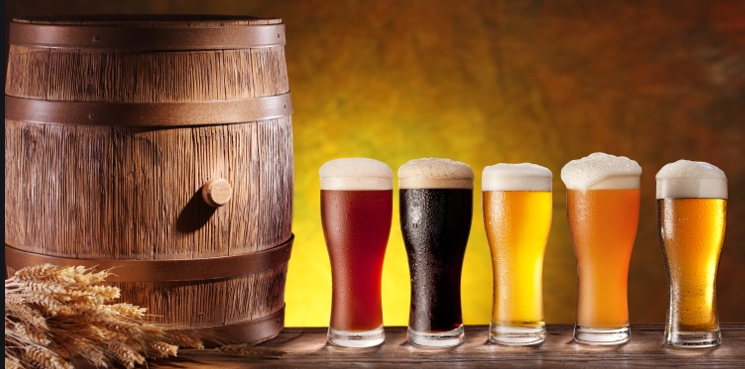

<div class="alert alert-block alert-danger"><b>In many of the problems you will see <font color=black>#TODO</font> statements added as comments on the code cell provided. You will want to be sure to complete each of these as indicated to avoid losing points.</b></div>

In [2]:
# load up modules
import pandas as pd
import numpy as np
# load for visuals
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

# set up notebook to display multiple output in one cell
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

<div class="alert alert-block alert-warning"><b>Summary of steps taken in this notebook:
    </b><br>
1. Deciding what to analyze - examine date ranges<br>
2. Look at outliers<br>
3. Creating new fields <br>
4. Are all fields created equal? <br>
5. Looking for the highly rated beers, breweries and beer styles <br>
6. Time Series plot - by days and by month <br>
7. Season analysis <br>
    
<b><u> Best practice</b></u> - we have discussed that the process of EDA is an iteration with each change to the data providing a new view of the data.  Depending on how you are manipulating the data, you should look at your data before a change and after a change so that you are confident that the code did as you expected.  The inspection of the data can be via any combination of shape, info, describe, boxplot, etc.
</div>

### Read in data


In [3]:
# read in file from module 5
df = pd.read_csv('beer_reviews_final.csv')

# what is the shape of the data
df.shape
# look at first five records
df.head()

(331554, 11)

,brewery_name,review_overall,review_aroma,review_appearance,review_profilename,beer_style,review_palate,review_taste,beer_name,beer_abv,review_date
0,Caldera Brewing Company,3.0,3.5,3.5,oline73,Herbed / Spiced Beer,3.0,3.5,Caldera Ginger Beer,4.7,2012-01-02 17:17:39
1,Caldera Brewing Company,3.5,3.5,3.5,Reidrover,Herbed / Spiced Beer,4.0,4.0,Caldera Ginger Beer,4.7,2011-10-19 02:25:15
2,Caldera Brewing Company,3.0,2.5,3.5,alpinebryant,Herbed / Spiced Beer,2.0,3.5,Caldera Ginger Beer,4.7,2011-05-24 22:26:58
3,Caldera Brewing Company,3.0,3.0,2.5,Beerandraiderfan,Oatmeal Stout,3.0,3.0,Caldera Oatmeal Stout,7.2,2011-09-14 18:40:12
4,Caldera Brewing Company,4.5,4.5,3.0,UCLABrewN84,Rauchbier,4.0,4.5,Rauch Ür Bock,7.4,2012-01-02 04:20:04


In [4]:
# check for nulls and for data types
# if you did your assignment correctly for module 5, there should be no nulls
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 331554 entries, 0 to 331553
Data columns (total 11 columns):
brewery_name          331554 non-null object
review_overall        331554 non-null float64
review_aroma          331554 non-null float64
review_appearance     331554 non-null float64
review_profilename    331554 non-null object
beer_style            331554 non-null object
review_palate         331554 non-null float64
review_taste          331554 non-null float64
beer_name             331554 non-null object
beer_abv              331554 non-null float64
review_date           331554 non-null object
dtypes: float64(6), object(5)
memory usage: 27.8+ MB


## Deciding what data to analyze - examine date ranges

In [5]:
# let's check out our date info
yearmonth = df['review_date'].str[0:7]

# We have all of 2011 and part of January 2012
yearmonth.value_counts().sort_index()

2011-01    28878
2011-02    27369
2011-03    28204
2011-04    25858
2011-05    27919
2011-06    26156
2011-07    27128
2011-08    28055
2011-09    25804
2011-10    25895
2011-11    25348
2011-12    25597
2012-01     9343
Name: review_date, dtype: int64

<div class="alert alert-block alert-success"><b>Problem 1 (2 pts.)</b>: Drop January 2012 from your data so that you are only analyzing the 12 months of 2011.  Show that your dataframe only contains 2011 data by showing a monthly count (see below).
    
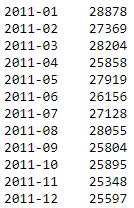
</div>

In [31]:
# TODO show the shape of your data
df.shape
# TODO only keep 2011 data for analysis
range = (df['review_date'] > '2010-12-31') & (df['review_date'] <= '2011-12-32')
df=df.loc[range]
df.head()
# TODO show the new shape of the data
df.shape
# TODO show your dataframe contains 2011 data with monthly counts
yearmonth2 = df['review_date'].str[0:7]
yearmonth2.value_counts().sort_index()


(331554, 11)

,brewery_name,review_overall,review_aroma,review_appearance,review_profilename,beer_style,review_palate,review_taste,beer_name,beer_abv,review_date
1,Caldera Brewing Company,3.5,3.5,3.5,Reidrover,Herbed / Spiced Beer,4.0,4.0,Caldera Ginger Beer,4.7,2011-10-19 02:25:15
2,Caldera Brewing Company,3.0,2.5,3.5,alpinebryant,Herbed / Spiced Beer,2.0,3.5,Caldera Ginger Beer,4.7,2011-05-24 22:26:58
3,Caldera Brewing Company,3.0,3.0,2.5,Beerandraiderfan,Oatmeal Stout,3.0,3.0,Caldera Oatmeal Stout,7.2,2011-09-14 18:40:12
5,Caldera Brewing Company,4.0,4.0,4.0,zaphodchak,Rauchbier,3.0,4.0,Rauch Ür Bock,7.4,2011-12-31 19:46:52
6,Caldera Brewing Company,4.0,4.5,4.0,Tilley4,Rauchbier,3.5,4.0,Rauch Ür Bock,7.4,2011-11-28 18:51:44


(322211, 11)

2011-01    28878
2011-02    27369
2011-03    28204
2011-04    25858
2011-05    27919
2011-06    26156
2011-07    27128
2011-08    28055
2011-09    25804
2011-10    25895
2011-11    25348
2011-12    25597
Name: review_date, dtype: int64

## Deciding what to analyze - looking at outliers

In examination of beer_abv using a boxplot, there appears to be outliers beyond 15 percent alcohol.

What are reasonable alcohol levels for beer?  According to the link provided, average alcohol levels for beer are around the 5 percent level. https://www.alcohol.org/statistics-information/abv/

There are a lot of values over 15, so next we'll take a closer look at them. Note that it is possible to specify the percentiles within describe( ).

count    322211.000000
mean          7.386064
std           2.427250
min           0.010000
25%           5.500000
50%           7.000000
75%           9.000000
95%          11.500000
max          57.700000
Name: beer_abv, dtype: float64

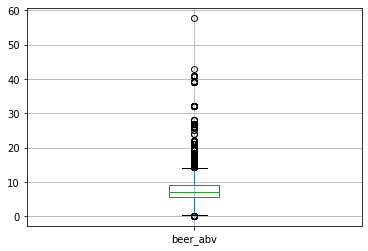

In [32]:
df['beer_abv'].describe(percentiles = [.25, .5, .75, .95])

df.boxplot(column = 'beer_abv')

Now we can isolate the beers with alcohol content over 15% and take a closer look.

In [33]:
# isolate beers with alcohol content over 15
x = df[df['beer_abv'] > 15]

# how many reviews are there? 2513
len(x)

# how many unique beers is that? 94
x['beer_name'].unique().shape

# do they look like valid abv values? Or are they mislabeled?
x
 

2513

(94,)

,brewery_name,review_overall,review_aroma,review_appearance,review_profilename,beer_style,review_palate,review_taste,beer_name,beer_abv,review_date
2908,Schorschbräu,4.0,3.5,2.5,MTNboy,Weizenbock,4.0,4.0,Schorsch Weizen 16%,16.00,2011-07-13 19:50:30
2909,Schorschbräu,4.0,4.0,4.0,kappldav123,Eisbock,4.0,3.5,Schorschbräu Schorschbock 57%,57.70,2011-09-23 12:28:21
2910,Schorschbräu,4.0,4.0,3.5,Sunnanek,Eisbock,4.0,4.0,Schorschbräu Schorschbock 43%,43.00,2011-07-06 17:42:58
2911,Schorschbräu,3.0,3.0,3.0,orangesol,Eisbock,2.0,3.0,Schorschbräu Schorschbock 40%,39.44,2011-11-11 19:59:11
10601,The Bruery,4.5,4.5,4.0,alcstradamus,American Strong Ale,4.5,4.5,Melange No. 3,15.50,2011-01-29 21:22:54
...,...,...,...,...,...,...,...,...,...,...,...
292573,Legend Brewing Co.,3.0,4.5,4.0,McKeag24,American Barleywine,3.0,3.5,Barleywine 2010,15.60,2011-03-11 18:11:45
292574,Legend Brewing Co.,4.0,3.5,3.5,ramseye4,American Barleywine,4.0,3.5,Barleywine 2010,15.60,2011-02-08 01:21:13
292575,Legend Brewing Co.,4.0,3.5,4.0,JCQ,American Barleywine,3.0,4.0,Barleywine 2010,15.60,2011-01-27 20:11:31
292576,Legend Brewing Co.,2.0,2.5,2.0,dragonWhale,American Barleywine,1.5,1.5,Barleywine 2010,15.60,2011-01-08 21:11:30


<div class="alert alert-block alert-success"><b>Problem 2 (2 pts.)</b>: The data appears to be valid and accurate as the beer name in many cases matches the percent alcohol (Schorsch Weizen 16% as an example). So there are real beers with high alcohol content. But the high alcohol content beers are unusual in the beer market and not mainstream enough for our client, so let's drop those with alcohol content above 11.5% from our analysis. Also, our client does not want to make a non-alcoholic beer so also drop any beer with less than 1% alcohol.
</div>

(322211, 11)

,brewery_name,review_overall,review_aroma,review_appearance,review_profilename,beer_style,review_palate,review_taste,beer_name,beer_abv,review_date
1,Caldera Brewing Company,3.5,3.5,3.5,Reidrover,Herbed / Spiced Beer,4.0,4.0,Caldera Ginger Beer,4.7,2011-10-19 02:25:15
2,Caldera Brewing Company,3.0,2.5,3.5,alpinebryant,Herbed / Spiced Beer,2.0,3.5,Caldera Ginger Beer,4.7,2011-05-24 22:26:58
3,Caldera Brewing Company,3.0,3.0,2.5,Beerandraiderfan,Oatmeal Stout,3.0,3.0,Caldera Oatmeal Stout,7.2,2011-09-14 18:40:12
5,Caldera Brewing Company,4.0,4.0,4.0,zaphodchak,Rauchbier,3.0,4.0,Rauch Ür Bock,7.4,2011-12-31 19:46:52
6,Caldera Brewing Company,4.0,4.5,4.0,Tilley4,Rauchbier,3.5,4.0,Rauch Ür Bock,7.4,2011-11-28 18:51:44


(305161, 11)

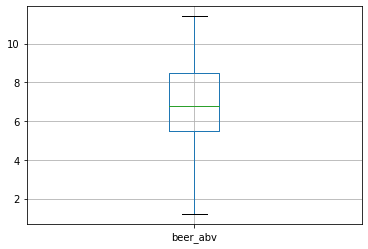

In [34]:
#TODO show the shape of your data
df.shape
#TODO Drop all beers with an alcohol content under 1 percent and over 11.5 percent
df = df[ (df['beer_abv'] < 11.5) & (df['beer_abv'] > 1 )]
df.head()
#TODO show the shape of your data
df.shape
#TODO display another boxplot to show beer_abv
df.boxplot(column = 'beer_abv')

In [35]:
# now look at how the change to the data affected the description stats
df['beer_abv'].describe(percentiles = [.25, .5, .75, .95])

count    305161.000000
mean          7.058213
std           1.905243
min           1.200000
25%           5.500000
50%           6.800000
75%           8.500000
95%          10.500000
max          11.410000
Name: beer_abv, dtype: float64

## Deciding what data to analyze - creating new fields

Since we're only interested in the data from 2011, we can extract just the month from our data and create a new column for this.

In [36]:
# create a new column for month
df['month'] = df['review_date'].str[5:7]
df['month'].value_counts()

01    27330
08    26782
03    26706
05    26315
02    25903
07    25686
06    24755
09    24744
10    24577
04    24487
11    23947
12    23929
Name: month, dtype: int64

One of the questions from our client is about seasonal beers. With this in mind, we'll create a dictionary called `seasons` that we will use later in our analysis. We will use our `month` variable as the key. We will do more with dictionaries next week, but until then here is some more information on them: __[dictionaries](https://docs.python.org/3/tutorial/datastructures.html#dictionaries)__

Note that `map( )` is a built-in function that is an iteration tool. More information can be found here: __[built-in functions](https://docs.python.org/3/library/functions.html#map)__

In [37]:
# create a dictionary called 'seasons' using the 'month' variable

seasons = {'01' : 'Winter', '12' : 'Winter', '02' : 'Winter',
           '03' : 'Spring', '04' : 'Spring', '05' : 'Spring',
           '06' : 'Summer', '07' : 'Summer', '08' : 'Summer',
           '09' : 'Fall',   '10' : 'Fall',   '11' : 'Fall'}
df['season'] = df['month'].map(seasons)
df.sample(5)

,brewery_name,review_overall,review_aroma,review_appearance,review_profilename,beer_style,review_palate,review_taste,beer_name,beer_abv,review_date,month,season
29714,SweetWater Brewing Company,3.5,3.5,3.5,HaroldStarr86,American Pale Ale (APA),3.5,4.0,Sweetwater 420 Extra Pale Ale,5.40,2011-08-03 14:31:41,08,Summer
156901,Sixpoint Brewery,4.5,4.0,4.0,sholland119,American IPA,4.0,4.5,Bengali Tiger,6.40,2011-11-16 01:33:31,11,Fall
246337,Dogfish Head Brewery,3.0,3.5,3.5,mactrail,American Stout,3.0,3.5,Chicory Stout,5.20,2011-12-30 05:06:01,12,Winter
302810,Deschutes Brewery,4.0,4.0,4.5,PDXHops,American Black Ale,4.0,4.0,Hop In The Dark Cascadian Dark Ale,6.90,2011-08-06 14:40:57,08,Summer
331318,Drake's Brewing Co.,3.5,4.0,4.5,HipHop5,American Double / Imperial IPA,3.5,4.0,Drake's Hopocalypse,9.25,2011-03-16 01:14:25,03,Spring


## Deciding what data to analyze - are all values created equal?

We will create a correlation matrix and Seaborn heatmap to investigate how rating, taste, and alcohol level are related. More information on creating a heatmap using Seaborn can be found here: __[Seaborn heatmap](https://seaborn.pydata.org/generated/seaborn.heatmap.html)__

What does the correlation matrix below tell us?  It tells us that there is a high positive correlation between the overall review score and the taste score which makes sense since good tasting beer should get a high overall rating. The red colored boxes in the heat map indicate slight negative relationships betwen the scores shown and the beer alcohol level. This is an interesting finding because it suggests that the amount of alcohol in the beer doesn't matter that much in terms of the ratings. <br>

Notice that the correlation matrix and the heatmap are two different ways to present the same data.

,review_overall,review_taste,beer_abv
review_overall,1.000000,0.845769,0.210811
review_taste,0.845769,1.000000,0.257105
beer_abv,0.210811,0.257105,1.000000


Text(0.5, 1, 'Heatmap Beer Review ratings')

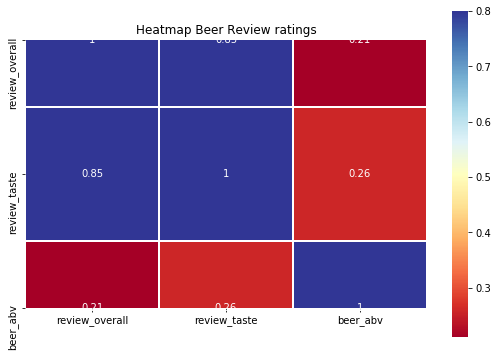

In [38]:
# setting the columns to correlate
columns = ['review_overall','review_taste', 'beer_abv']
df_corr = df[columns]
# running the correlation
df_corr.corr()

# setting up the heatmap
corrmat = df_corr.corr()

# set the figure size
f, ax = plt.subplots(figsize=(9, 6))

# pass the data and set the parameters
sns.heatmap(corrmat, vmax=.8, square=True, annot=True, cmap='RdYlBu', linewidths=.5 )
plt.title('Heatmap Beer Review ratings')

# images can be saved - default is .png
# https://matplotlib.org/3.1.1/api/_as_gen/matplotlib.pyplot.savefig.html
plt.savefig('Correlation Heat Map Beer Reviews')

<div class="alert alert-block alert-success"><b>Problem 3 (3 pts.)</b>: Create a data matrix with all six of the numeric variables in the dataframe and create a heatmap using all six numeric variables with a new color scheme. Explain how the visual cues of the heatmap represent the correlations.
</div>

,review_overall,review_taste,beer_abv,review_aroma,review_appearance,review_palate
review_overall,1.000000,0.845769,0.210811,0.682232,0.522982,0.718955
review_taste,0.845769,1.000000,0.257105,0.680354,0.485256,0.691498
beer_abv,0.210811,0.257105,1.000000,0.296680,0.246809,0.244869
review_aroma,0.682232,0.680354,0.296680,1.000000,0.493633,0.556384
review_appearance,0.522982,0.485256,0.246809,0.493633,1.000000,0.513925
review_palate,0.718955,0.691498,0.244869,0.556384,0.513925,1.000000


Text(0.5, 1, 'Heatmap Beer Review ratings')

A color closer to pink represents higher correlation, while teel represents low correlation.


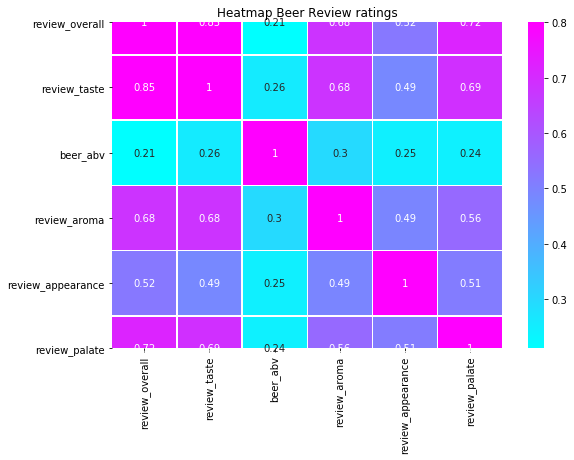

In [40]:
# TODO create a data matrix using all six numeric variables
columns = ['review_overall','review_taste', 'beer_abv','review_aroma','review_appearance','review_palate']
df_corr = df[columns]
df_corr.corr()
# TODO create a heat map using all six numeric variables. Pick a new color combination.
# https://matplotlib.org/3.1.1/gallery/color/colormap_reference.html
corrmat = df_corr.corr()
f, ax = plt.subplots(figsize=(9, 6))
sns.heatmap(corrmat, vmax=.8, square=True, annot=True, cmap='cool', linewidths=.5 )
plt.title('Heatmap Beer Review ratings')
plt.savefig('Correlation Heat Map Beer Reviews')

#TODO explain how the visual cues of the heatmap represent the correlactions.
print("A color closer to pink represents higher correlation, while teel represents low correlation.")

## Deciding what to analyze - looking for the highly rated beers

The `review_overall` score was highly correlated enough with all of the other review scores that we will use just the `review_overall` score for our analysis on top beers.

Let's look at top beers three different ways: by brewery, by style, and by individual beer.

In [41]:
# look at mean of overall review and the number of reviews
brewery =df['review_overall'].groupby(df['brewery_name']).agg(['mean','count'])

# Notice that looking at just the mean is misleading as those that have a rating 5.0 have only 1 
#     or 2 reviews
# we could eliminate the low count, or instead focus on the high count
# 
brewery.sort_values(by=['count'], ascending = False)[:20]
brewery.sort_values(by=['mean'], ascending = False)[:10]

,mean,count
brewery_name,,
Boston Beer Company (Samuel Adams),3.659130,8050
Sierra Nevada Brewing Co.,3.976662,7327
Stone Brewing Co.,3.979630,6873
Dogfish Head Brewery,3.904645,5899
Founders Brewing Company,4.227471,5038
"Bell's Brewery, Inc.",3.955363,4615
Lagunitas Brewing Company,3.980979,3943
New Belgium Brewing,3.809727,3876
Southern Tier Brewing Company,3.859581,3340


,mean,count
brewery_name,,
Pivara Tuzla,5.0,2
Thai Me Up,5.0,1
Liebhart's Privatbrauerei Detmold,5.0,1
Moccasin Bend Brewing Co.,5.0,1
Brauerei Gundel,5.0,1
Callahan's Pub & Brewery,5.0,1
Blue Corn Brewery,5.0,1
Round Guys Brewing Company,5.0,1
4 Hands Brewing Co.,5.0,2


In [42]:
# repeat for beer style
beerStyle =df['review_overall'].groupby(df['beer_style']).agg(['mean','count'])
beerStyle.sort_values(by=['count'], ascending = False)[:20]

,mean,count
beer_style,,
American IPA,3.904576,27886
American Double / Imperial IPA,4.021341,22632
American Pale Ale (APA),3.815287,12422
American Double / Imperial Stout,4.056087,11393
Russian Imperial Stout,3.992155,10453
American Porter,3.887210,10227
Saison / Farmhouse Ale,3.906139,9301
American Amber / Red Ale,3.767042,7995
American Wild Ale,4.067593,6332


In [43]:
# repeat for beer name
beers =df['review_overall'].groupby(df['beer_name']).agg(['mean','count'])
beers.sort_values(by=['count'], ascending = False)[:20]

,mean,count
beer_name,,
Pliny The Elder,4.614130,736
Bell's Hopslam Ale,4.436519,701
Stone 15th Anniversary Escondidian Imperial Black IPA,4.158768,633
Double Jack,4.200949,632
Founders Breakfast Stout,4.450886,621
Old Rasputin Russian Imperial Stout,4.314414,555
Founders KBS (Kentucky Breakfast Stout),4.548358,548
Hoptimum Double IPA - Beer Camp #19,3.850093,537
Two Hearted Ale,4.248062,516


In [44]:
# a table heat map can help point out top values
z = brewery.sort_values(by=['count'], ascending = False)[:50]
z.style.background_gradient(cmap = 'Blues')

# what does this heatmap help us see?
# top breweries to investigate based on review_overall 
#  Russian River Brewing Company
#  Brasserie Cantillian
#  Founders Brewing Company
#  Surly Brewing Company


,mean,count
brewery_name,,
Boston Beer Company (Samuel Adams),3.65913,8050
Sierra Nevada Brewing Co.,3.97666,7327
Stone Brewing Co.,3.97963,6873
Dogfish Head Brewery,3.90464,5899
Founders Brewing Company,4.22747,5038
"Bell's Brewery, Inc.",3.95536,4615
Lagunitas Brewing Company,3.98098,3943
New Belgium Brewing,3.80973,3876
Southern Tier Brewing Company,3.85958,3340


<div class="alert alert-block alert-success"><b>Problem 4 (4 pts.)</b>: Create a heat map for both beer styles and for individual beers showing the top 50 based on the count of review_overall.  Which three beer styles are top rated and which three individual beers are top rated?  Optional: create the heatmap with different colors.
</div>

In [46]:
# TODO create a heatmap for beer styles
a= beerStyle.sort_values(by=['count'], ascending = False)[:50]
a.style.background_gradient(cmap = 'Reds') 
# TODO list top three beer styles based on mean rating
style_mean= beerStyle.sort_values(by=['mean'], ascending = False)[:3]
style_mean

,mean,count
beer_style,,
American IPA,3.90458,27886
American Double / Imperial IPA,4.02134,22632
American Pale Ale (APA),3.81529,12422
American Double / Imperial Stout,4.05609,11393
Russian Imperial Stout,3.99216,10453
American Porter,3.88721,10227
Saison / Farmhouse Ale,3.90614,9301
American Amber / Red Ale,3.76704,7995
American Wild Ale,4.06759,6332


,mean,count
beer_style,,
Gueuze,4.171088,1847
Quadrupel (Quad),4.101786,3360
Lambic - Unblended,4.095318,299


In [47]:
# TODO create a heatmap for individual beers
b= beers.sort_values(by=['count'], ascending = False)[:50]
b.style.background_gradient(cmap = 'Greens') 
# TODO list top three beers based on mean rating
beer_mean= beers.sort_values(by=['mean'], ascending = False)[:3]
beer_mean 

,mean,count
beer_name,,
Pliny The Elder,4.61413,736
Bell's Hopslam Ale,4.43652,701
Stone 15th Anniversary Escondidian Imperial Black IPA,4.15877,633
Double Jack,4.20095,632
Founders Breakfast Stout,4.45089,621
Old Rasputin Russian Imperial Stout,4.31441,555
Founders KBS (Kentucky Breakfast Stout),4.54836,548
Hoptimum Double IPA - Beer Camp #19,3.85009,537
Two Hearted Ale,4.24806,516


,mean,count
beer_name,,
Gaffers Bitter,5.0,2
C4 Red Ale,5.0,1
Reprise Centennial Red,5.0,1


There are plenty of ways to slice and dice data. A heatmap is a nice visual, but there are other ways to analyse the data. Below is an example of an easy way to change the count number to see if lower count reviews have a higher review score.

Try changing the comparison value of 600 to 400 and see how the results change.

In [48]:
# set the comparison value to more than 600

temp = beers[beers['count'] > 600]
temp['mean'].nlargest(5)

# change the comparison value of 600 above to 400 and see how the results change

beer_name
Pliny The Elder                                          4.614130
Founders Breakfast Stout                                 4.450886
Bell's Hopslam Ale                                       4.436519
Double Jack                                              4.200949
Stone 15th Anniversary Escondidian Imperial Black IPA    4.158768
Name: mean, dtype: float64

## Time Series plot

Next we will look at our total number of beer reviews by day.  Note that when data is stored in a csv file, it does not retain the date field type; the review_date in this module was read in as an Object - which is the default.

There are a few ways to handle date fields.  If you know you are reading in a date field from a csv file, you can specify so in the read_csv command:
df = pd.read_csv('beer6.csv',parse_dates = ['review_date'])

Or you can convert a date in an Object field into a Date field, which is shown below.

In [51]:
# convert review_date to a date format
df['review_date'] = pd.to_datetime(df['review_date'])
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 305161 entries, 1 to 331553
Data columns (total 13 columns):
brewery_name          305161 non-null object
review_overall        305161 non-null float64
review_aroma          305161 non-null float64
review_appearance     305161 non-null float64
review_profilename    305161 non-null object
beer_style            305161 non-null object
review_palate         305161 non-null float64
review_taste          305161 non-null float64
beer_name             305161 non-null object
beer_abv              305161 non-null float64
review_date           305161 non-null datetime64[ns]
month                 305161 non-null object
season                305161 non-null object
dtypes: datetime64[ns](1), float64(6), object(6)
memory usage: 42.6+ MB


In [52]:
# to plot by date, we need one sum for each date
# lets group by date and create a df that we can plot
df_date = pd.DataFrame(df['review_overall'].groupby(df['review_date']).count())
df_date.sample(5)
# the date is the index and it needs to be reset so it can be used as a regular column
df_date = df_date.reset_index()
df_date.info()

,review_overall
review_date,
2011-01-28 06:04:21,1
2011-11-04 14:28:56,1
2011-11-20 08:32:08,1
2011-03-30 13:35:45,1
2011-07-28 03:35:41,1


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 302894 entries, 0 to 302893
Data columns (total 2 columns):
review_date       302894 non-null datetime64[ns]
review_overall    302894 non-null int64
dtypes: datetime64[ns](1), int64(1)
memory usage: 4.6 MB


## Two different plots showing the same information

Shown below are plots of the beer review counts for each day.  The top graph is using Matplotlib and the bottom graph is using Plotly. Here is more information on those:

__[matplotlib simple plot](https://matplotlib.org/3.1.0/gallery/lines_bars_and_markers/simple_plot.html#sphx-glr-gallery-lines-bars-and-markers-simple-plot-py)__

__[plotly discrete colors](https://plotly.com/python/discrete-color/)__

__[plotly text and annotations](https://plotly.com/python/text-and-annotations/)__

Both plot styles have plenty of features that can be customized and you are encouraged to experiement with the customizations. We will be updating the plot title along with the labels for the x and y axis.

[Text(0.5, 0, 'Review Date')]

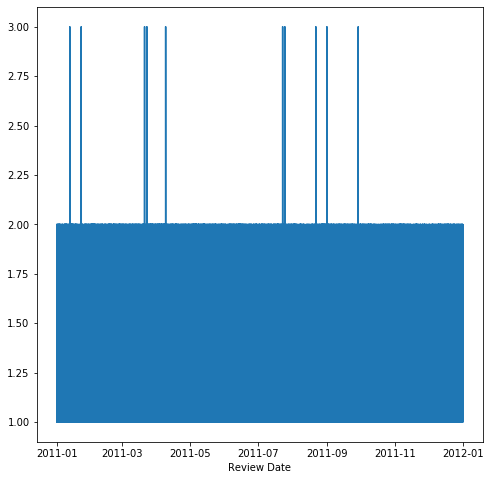

In [53]:
# matplotlib version of plot

fig, ax = plt.subplots(figsize = (8,8))

ax.plot(df_date['review_date'], df_date['review_overall'])
ax.set(xlabel = 'Review Date')

In [70]:
# plotly version of plot - notice the info on hover

fig = px.line(df_date, x = 'review_date', y = 'review_overall',  
        title='Beer Review Count by Date')  

fig.update_layout(height = 600, xaxis_title = 'Review Date')

# hover over Feb 13 to see counts

<div class="alert alert-block alert-success"><b>Problem 5 (4 pts.)</b>: Create a new line plot using the count of reviews showing for each month (new x axis value).  Your figure is to include a <b><font color=black>title, x and y axis labels</font></b>.  You can choose to either use Matplotlib or Plotly.  You will need to prep the data and then display the plot.
</div>

In [76]:
# TODO create your dataframe that groups the review_overall count by month
df_month = pd.DataFrame(df['review_overall'].groupby(df['month']).count())
df_month
df_month = df_month.reset_index()
df_month.info()

,review_overall
month,
01,27330
02,25903
03,26706
04,24487
05,26315
06,24755
07,25686
08,26782
09,24744


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12 entries, 0 to 11
Data columns (total 2 columns):
month             12 non-null object
review_overall    12 non-null int64
dtypes: int64(1), object(1)
memory usage: 320.0+ bytes


[Text(0.5, 0, 'month')]

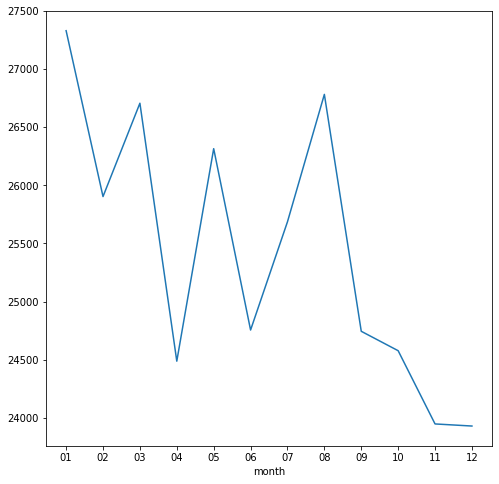

In [77]:
# TODO create a plot with Month on the x axis and counts on the y axis; Include a title, x and y axis label.
fig, ax = plt.subplots(figsize = (8,8))

ax.plot(df_month['month'], df_month['review_overall'])
ax.set(xlabel = 'month')

## Seasons

We already created a variable so that each review has a value of either Summer, Sprint, Winter or Fall.  We want to know if there are beers that have a high number of ratings in one season which suggests they are a special beer with seasonal release.

In [78]:
df50 = pd.DataFrame(pd.crosstab(df['beer_name'],df['season'])) 
# get a total count of reviews per beer
df50['Total'] = df50['Fall'] + df50['Spring'] + df50['Summer'] + df50['Winter']
df50.head(10)

season,Fall,Spring,Summer,Winter,Total
beer_name,,,,,
"""Jessica & Brendan's"" Bridal Ale",0,1,0,0,1
"""Just One More"" Scotch Ale",3,0,1,0,4
"""Naughty Scot"" Scotch Ale",0,1,0,0,1
"""Requisite"" Imperialistic Stout",0,0,1,2,3
"""Shabadoo"" Black & Tan Ale",2,7,3,2,14
"""The Buk"" Pale Ale",1,1,2,3,7
"""The Camp"" Barleywine",0,0,0,1,1
"""The Wind Cried Mari..."" Scottish Heather Ale",0,1,0,0,1
"""Woosta"" Weizenbock",1,0,2,0,3


In [79]:
# We don't want beers with few reviews, so only keep beers with 50 or more reviews
df50 = df50[df50['Total'] >= 50]
df50 = df50.reset_index()
df50.head()

season,beer_name,Fall,Spring,Summer,Winter,Total
0,#9,46,56,76,56,234
1,10 Commandments,13,16,15,15,59
2,1000 IBU,8,27,11,21,67
3,110K+OT Batch #4 - Imperial Red Ale,14,10,40,1,65
4,1554 Enlightened Black Ale,50,38,45,62,195


In [80]:
# lets caculate percentages of total for each season

df50['fallPercent'] = (df50['Fall']/df50['Total']) * 100
df50['springPercent'] = (df50['Spring']/df50['Total']) * 100
df50['summerPercent'] = (df50['Summer']/df50['Total']) * 100
df50['winterPercent'] = (df50['Winter']/df50['Total']) * 100
df50.info()
df50.sample(5)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458 entries, 0 to 1457
Data columns (total 10 columns):
beer_name        1458 non-null object
Fall             1458 non-null int64
Spring           1458 non-null int64
Summer           1458 non-null int64
Winter           1458 non-null int64
Total            1458 non-null int64
fallPercent      1458 non-null float64
springPercent    1458 non-null float64
summerPercent    1458 non-null float64
winterPercent    1458 non-null float64
dtypes: float64(4), int64(5), object(1)
memory usage: 114.0+ KB


season,beer_name,Fall,Spring,Summer,Winter,Total,fallPercent,springPercent,summerPercent,winterPercent
936,Oud Beersel Oude Geuze Vieille,15,20,26,23,84,17.857143,23.809524,30.952381,27.380952
308,Clementine,30,26,37,27,120,25.000000,21.666667,30.833333,22.500000
1184,Sierra Nevada Kellerweis Hefeweizen,41,68,80,47,236,17.372881,28.813559,33.898305,19.915254
897,Oatmeal Stout,61,65,48,77,251,24.302789,25.896414,19.123506,30.677291
1099,Samuel Adams Wee Heavy (Imperial Series),32,96,44,14,186,17.204301,51.612903,23.655914,7.526882


In [81]:
# let's look at Spring to see if any beers have the majority of reviews in Spring
df50[df50['springPercent'] > 75]

season,beer_name,Fall,Spring,Summer,Winter,Total,fallPercent,springPercent,summerPercent,winterPercent
90,ApriHop,9,242,23,14,288,3.125000,84.027778,7.986111,4.861111
240,Brooklyn Main Engine Start,1,50,13,1,65,1.538462,76.923077,20.000000,1.538462
468,Fluffy White Rabbits,2,50,9,0,61,3.278689,81.967213,14.754098,0.000000
719,Koko Brown,3,48,4,5,60,5.000000,80.000000,6.666667,8.333333
815,Mayflower Spring Hop,1,49,3,0,53,1.886792,92.452830,5.660377,0.000000
861,Narragansett Bock,0,43,10,0,53,0.000000,81.132075,18.867925,0.000000
968,Peak Organic Simcoe Spring,1,40,1,10,52,1.923077,76.923077,1.923077,19.230769
1060,Saint Arnold Divine Reserve #11,6,94,21,1,122,4.918033,77.049180,17.213115,0.819672


<div class="alert alert-block alert-success"><b>Problem 6 (2 pts.)</b>: Show the number of beers for each season that have over 75 percent of their reviews in one season.<br>
    
The output should show the season and the number of beers that qualify where x represents the count: <br>
Spring has x beers <br>
Summer has x beers <br>
Fall has x beers <br>
Winter ha x beers
</div>

In [0]:
# TODO Show the beer review counts for each season with over 75 percent per season


<div class="alert alert-block alert-success"><b>Problem 7 (1 pts.)</b>: Which beer(s) would you suggest the client to look at in regards to a seasonal beer and why? 
</div>

In [0]:
# TODO Which beer(s) would you suggest that the client to look at in regards to a seasonal beer and why?
